# Install Libraries

In [1]:
!pip install -U git+https://github.com/albu/albumentations --no-cache-dir
! pip uninstall opencv-python
! pip install opencv-python==4.5.2.54

  Cloning https://github.com/albu/albumentations to /tmp/pip-req-build-_vk3h4pv
  Running command git clone -q https://github.com/albu/albumentations /tmp/pip-req-build-_vk3h4pv
Found existing installation: opencv-python 4.5.2.54
Uninstalling opencv-python-4.5.2.54:
  Would remove:
    /usr/local/lib/python3.7/dist-packages/cv2/*
    /usr/local/lib/python3.7/dist-packages/opencv_python-4.5.2.54.dist-info/*
    /usr/local/lib/python3.7/dist-packages/opencv_python.libs/libQt5Concurrent-21c64331.so.5.15.0
    /usr/local/lib/python3.7/dist-packages/opencv_python.libs/libQt5Core-d92f2856.so.5.15.0
    /usr/local/lib/python3.7/dist-packages/opencv_python.libs/libQt5Gui-ca084835.so.5.15.0
    /usr/local/lib/python3.7/dist-packages/opencv_python.libs/libQt5Test-9d4ee57e.so.5.15.0
    /usr/local/lib/python3.7/dist-packages/opencv_python.libs/libQt5Widgets-0e1d98b5.so.5.15.0
    /usr/local/lib/python3.7/dist-packages/opencv_python.libs/libQt5XcbQpa-70670cdb.so.5.15.0
    /usr/local/lib/python3.7

In [2]:
%matplotlib inline

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Import Libraries

In [4]:
import os
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torch.utils.data import Dataset as BaseDataset
from torchvision.datasets.vision import VisionDataset
from torchvision import transforms
import pathlib
from copy import deepcopy
import cv2
import albumentations as albu
import matplotlib.pyplot as plt
import time
import copy

# Define Paths

In [5]:
data_dir = '/content/drive/My Drive/Remote Sensing Image Analysis/assignment2/report2/data/'
model_dir = '/content/drive/My Drive/Remote Sensing Image Analysis/assignment2/report2/model/'
pred_dir = '/content/drive/My Drive/Remote Sensing Image Analysis/assignment2/report2/result/'

x_train_dir = os.path.join(data_dir, 'train_img')
y_train_dir = os.path.join(data_dir, 'train_label')

x_val_dir = os.path.join(data_dir, 'val_img')
y_val_dir = os.path.join(data_dir, 'val_label')

# Define Configurations

In [6]:
batch_size = 8
epochs = 60
img_size = 256
in_ch = 3 # number of input channels (RGB)
out_ch = 1 # number of output channels (1 for binary classification)
prediction_threshold = 0.5
model_name = 'unet'
model_file = "%s_E%d_B%d.pth"%(model_name, epochs, batch_size)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Define Dataset Class

In [7]:
# Reference: https://github.com/qubvel/segmentation_models.pytorch

class SemanticSegmentationDataset(VisionDataset):
    CLASSES = [
        "nonbuilding",
        "building",
    ]

    def __init__(
        self,
        images_dir,
        masks_dir,
        classes=None,
        augmentation=None,
    ):
        self.images_dir = images_dir
        self.masks_dir = masks_dir
        self.rgb_list = self._get_rgb_list()

        # convert str names to class values on masks
        self.class_values = [self.CLASSES.index(cls.lower()) for cls in classes]
        self.augmentation = augmentation

    def _get_rgb_list(self):
        return list(sorted(pathlib.Path(self.images_dir).glob("*.png")))

    def __len__(self):
        return len(self.rgb_list)

    def __getitem__(self, index):
        rgb_path = self.rgb_list[index]
        rgb_fname = rgb_path.stem
        cls_path = os.path.join(self.masks_dir, rgb_fname + '.png')

        #image = imread(str(rgb_path))
        image = cv2.imread(str(rgb_path), cv2.IMREAD_COLOR)

        #mask = imread(str(cls_path))
        mask = cv2.imread(str(cls_path), cv2.IMREAD_UNCHANGED)
        mask[mask < 255] = 0  # non-buildings
        mask[mask == 255] = 1  # buildings
        mask = mask.astype('int64')

        # extract certain classes from mask (e.g. building)
        masks = [(mask == v) for v in self.class_values]
        mask = np.stack(masks, axis=-1).astype('int64')

        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']

        return image, mask, str(rgb_path)

# Define Augmentation Helper Functions

In [8]:
# Reference: https://github.com/albumentations-team/albumentations

def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')

def to_tensor_labels(x, **kwargs):
    return x.transpose(2, 0, 1).astype('int64')

def get_training_augmentation():
    train_transform = [
        albu.HorizontalFlip(p=0.5),
        albu.VerticalFlip(p=0.5),
        albu.RandomRotate90(p=0.5),
        albu.Transpose(p=0.5),
        albu.RandomCrop(height=img_size, width=img_size, p=0.5),
        albu.Resize(img_size,img_size),
        albu.Lambda(image=to_tensor,mask=to_tensor)
    ]

    return albu.Compose(train_transform)

def get_val_augmentation():
    test_transform = [
        albu.Resize(img_size,img_size),
        albu.Lambda(image=to_tensor,mask=to_tensor)
    ]

    return albu.Compose(test_transform)

def get_IoU(pred_mask, mask, eps=1e-10):
    iou = None

    with torch.no_grad():
        intersection = torch.sum(mask * pred_mask)
        union = torch.sum(mask) + torch.sum(pred_mask) - intersection + eps
        iou = (intersection + eps) / union

    return iou

# Define Model Class

In [13]:
# Reference: https://github.com/gbaier/rs_img_synth/blob/master/models/unet.py

class UNet(nn.Module):
    def __init__(self, in_channels, n_classes, n_downsample=4):
        """
        Implementation of
        U-Net: Convolutional Networks for Biomedical Image Segmentation
        (Ronneberger et al., 2015)
        https://arxiv.org/abs/1505.04597
        Args:
            in_channels (int): number of input channels
            n_classes (int): number of output channels
            n_downsample (int): depth of the network
        """
        super().__init__()

        # input and output channels for the downsampling path
        out_channels = [64 * (2 ** i) for i in range(n_downsample)]
        in_channels = [in_channels] + out_channels[:-1]

        self.down_path = nn.ModuleList(
            [self._make_unet_conv_block(ich, och) for ich, och in zip(in_channels, out_channels)]
        )

        # input channels of the upsampling path
        in_channels = [64 * (2 ** i) for i in range(n_downsample, 0, -1)]
        self.body = self._make_unet_conv_block(out_channels[-1], in_channels[0])

        self.upsamplers = nn.ModuleList(
            [self._make_upsampler(nch, nch // 2) for nch in in_channels]
        )

        self.up_path = nn.ModuleList(
            [self._make_unet_conv_block(nch, nch // 2) for nch in in_channels]
        )

        self.last = nn.Conv2d(64, n_classes, kernel_size=1)

        self._return_intermed = False

    @staticmethod
    def _make_unet_conv_block(in_channels, out_channels):
        return nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.ReLU(),
        )

    @property
    def return_intermed(self):
        return self._return_intermed

    @return_intermed.setter
    def return_intermed(self, value):
        self._return_intermed = value

    def _make_upsampler(self, in_channels, out_channels):
        return nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)

    def forward(self, x):
        blocks = []
        for down in self.down_path:
            # UNet conv block increases the number of channels
            x = down(x)
            blocks.append(x)
            # Downsampling, by mass pooling
            x = F.max_pool2d(x, 2)

        x = self.body(x)

        for upsampler, up, block in zip(self.upsamplers, self.up_path, reversed(blocks)):
            # upsample and reduce number of channels
            x = upsampler(x)
            x = torch.cat([x, block], dim=1)
            # UNet conv block reduces the number of channels again
            x = up(x)

        x = self.last(x)
        x = nn.Sigmoid()(x)

        if self.return_intermed:
            return x, blocks

        return x

# Define Training Helper Functions

In [14]:
# Reference: https://pytorch.org/tutorials/beginner/transfer_learning_tutorial.html

def adjust_learning_rate(optimizer, decay=0.1):
    for param_group in optimizer.param_groups:
        param_group['lr'] = decay * param_group['lr']

def train_model(model, criterion, optimizer, loader, n_epochs=25):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0
    best_iou = 0.0

    train_accs = []
    val_accs = []
    train_ious = []
    val_ious = []
    train_losses = []
    val_losses = []

    lr_decay_gamma = 0.1

    for epoch in range(1, n_epochs + 1):
        print('Epoch {}/{}'.format(epoch, n_epochs))
        print('-' * 10)

        if epoch == 50:
            adjust_learning_rate(optimizer, lr_decay_gamma)
            print('Decrease decoder learning rate!')

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0
            running_iou = 0.0

            # Iterate over data
            for x, y, f in loader[phase]:
                img_in = x.to(device).float()
                img_out = y.to(device).float()

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    output = model.forward(img_in)
                    loss = criterion(output, img_out)
                    pred = (output > prediction_threshold).long()
                    iou = get_IoU(pred, img_out)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * img_in.size(0)
                running_iou += iou * img_in.size(0)
                running_corrects += torch.sum(pred == img_out)

            epoch_loss = running_loss / len(loader[phase].dataset)
            epoch_iou = running_iou / len(loader[phase].dataset)

            if phase == 'train':
                epoch_acc = running_corrects.double() / (len(loader[phase].dataset) * img_size * img_size)
                train_accs.append(epoch_acc)
                train_ious.append(epoch_iou)
                train_losses.append(epoch_loss)
            else:
                epoch_acc = running_corrects.double() / (len(loader[phase].dataset) * img_size * img_size)
                val_accs.append(epoch_acc)
                val_ious.append(epoch_iou)
                val_losses.append(epoch_loss)

            print('{} Loss: {:.4f} Acc: {:.4f} IoU: {:.4f}'.format(phase, epoch_loss, epoch_acc, epoch_iou))
            
            # deep copy the model
            if phase == 'val' and epoch_iou > best_iou:
                best_iou = epoch_iou
                best_model_wts = copy.deepcopy(model.state_dict())
                torch.save(model, model_dir + model_file)
                print('Model saved!')
            
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))
    print('Best val IoU: {:4f}'.format(best_iou))

    print('IoU visualization:')
    plt.plot(np.array(train_ious), 'r')
    plt.plot(np.array(val_ious), 'b')
    plt.show()

    print('Loss visualization:')
    plt.plot(np.array(train_losses), 'r')
    plt.plot(np.array(val_losses), 'b')
    plt.show()

    print('Accuracy visualization:')
    plt.plot(np.array(train_accs), 'r')
    plt.plot(np.array(val_accs), 'b')
    plt.show()

    # load best model weights
    model.load_state_dict(best_model_wts)

    return model

# Define Datasets

In [15]:
CLASSES = ["building"]

train_dataset = SemanticSegmentationDataset(
    x_train_dir,
    y_train_dir,
    augmentation=get_training_augmentation(),
    classes=CLASSES,
    )

val_dataset = SemanticSegmentationDataset(
    x_val_dir,
    y_val_dir,
    augmentation=get_val_augmentation(),
    classes=CLASSES,
    )

dataloaders = {'train': DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=1),
              'val': DataLoader(val_dataset, batch_size=1, shuffle=False, num_workers=1)}

# Train Model

Epoch 1/60
----------
train Loss: 0.4404 Acc: 0.8707 IoU: 0.0053
val Loss: 0.3135 Acc: 0.8864 IoU: 0.1999
Model saved!
Epoch 2/60
----------
train Loss: 0.3347 Acc: 0.8626 IoU: 0.1018
val Loss: 0.3171 Acc: 0.8684 IoU: 0.2330
Model saved!
Epoch 3/60
----------
train Loss: 0.3397 Acc: 0.8651 IoU: 0.0709
val Loss: 0.3061 Acc: 0.8878 IoU: 0.2109
Epoch 4/60
----------
train Loss: 0.3259 Acc: 0.8696 IoU: 0.0731
val Loss: 0.3721 Acc: 0.8000 IoU: 0.2299
Epoch 5/60
----------
train Loss: 0.3382 Acc: 0.8675 IoU: 0.0723
val Loss: 0.3150 Acc: 0.8869 IoU: 0.2238
Epoch 6/60
----------
train Loss: 0.3226 Acc: 0.8709 IoU: 0.0768
val Loss: 0.2916 Acc: 0.8901 IoU: 0.2238
Epoch 7/60
----------
train Loss: 0.3073 Acc: 0.8773 IoU: 0.0696
val Loss: 0.2784 Acc: 0.8883 IoU: 0.2130
Epoch 8/60
----------
train Loss: 0.3129 Acc: 0.8766 IoU: 0.0934
val Loss: 0.2808 Acc: 0.8871 IoU: 0.2032
Epoch 9/60
----------
train Loss: 0.3110 Acc: 0.8737 IoU: 0.1011
val Loss: 0.2770 Acc: 0.8906 IoU: 0.2791
Model saved!
Epoch 1

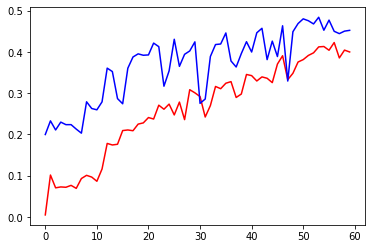

Loss visualization:


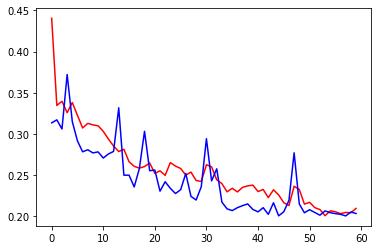

Accuracy visualization:


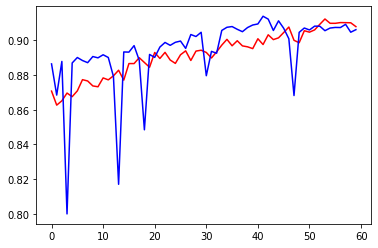

In [16]:
train_mode = True

criterion = torch.nn.BCELoss()
model = UNet(in_ch, out_ch).to(device)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)

if train_mode == True:
  model = train_model(model, criterion, optimizer, dataloaders, epochs)
else:
  # load best saved checkpoint
  model = torch.load(model_dir + model_file)

# Find the Best Threshold on Validation Set

In [17]:
from pickle import NONE
# ======================
# Visualize results for val set
# ======================

model.eval()

thresholds = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0]

max_iou = 0.0
chosen_threshold = None

for curr_threshold in thresholds:
    total_iou = 0.0

    for n in range(len(val_dataset)):
        input, output, rgb_path = val_dataset[n]
        x_tensor = torch.from_numpy(input).to(device).unsqueeze(0)
        output = output.squeeze()

        prediction = model(x_tensor)
        prediction = (prediction > curr_threshold).long()
        tensor_output = torch.Tensor(output).view(1, 1, 256, 256).to(device)
        iou = get_IoU(prediction, tensor_output)

        total_iou += iou

    curr_iou = total_iou / len(val_dataset)

    if curr_iou > max_iou:
        max_iou = curr_iou
        chosen_threshold = curr_threshold

print("Max IoU: ", max_iou)
print("Chosen threshold: ", chosen_threshold)
prediction_threshold = chosen_threshold

Max IoU:  tensor(0.4838, device='cuda:0')
Chosen threshold:  0.5


# Visualize Predicted Label Images in Validation Set

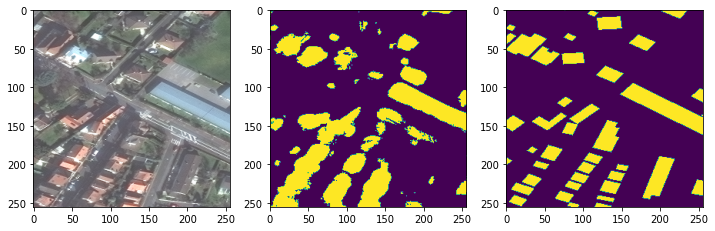

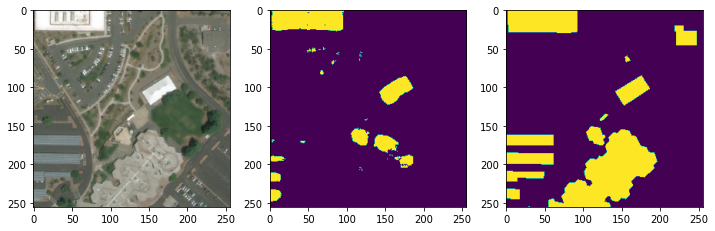

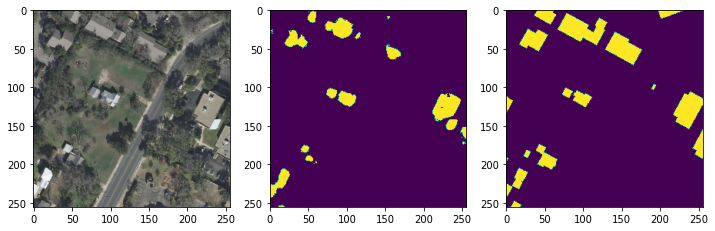

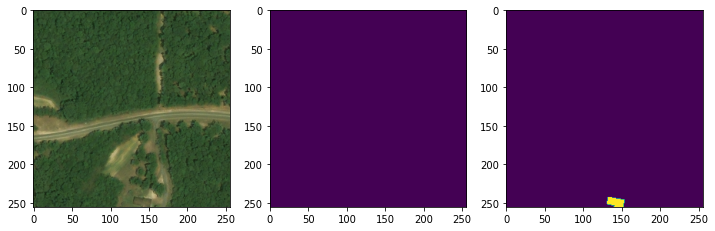

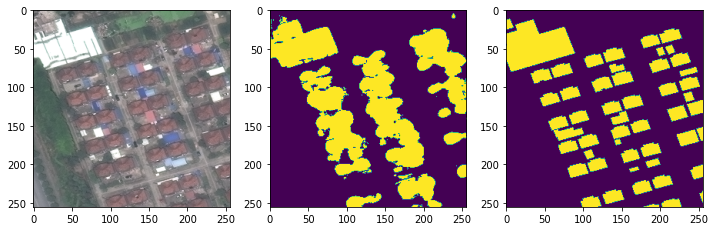

...

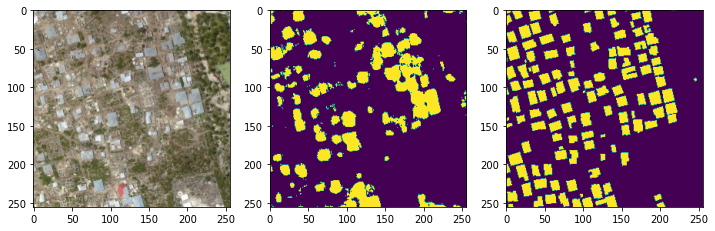

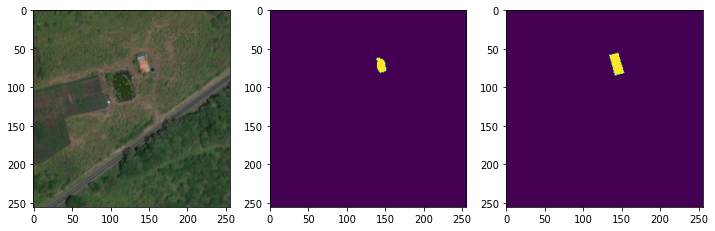

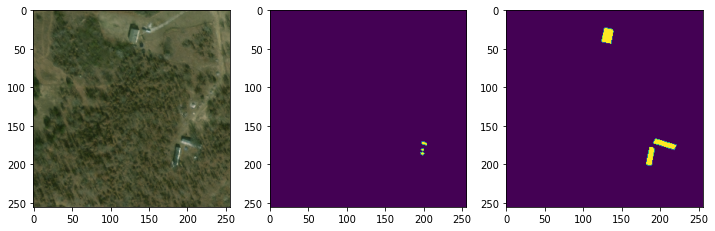

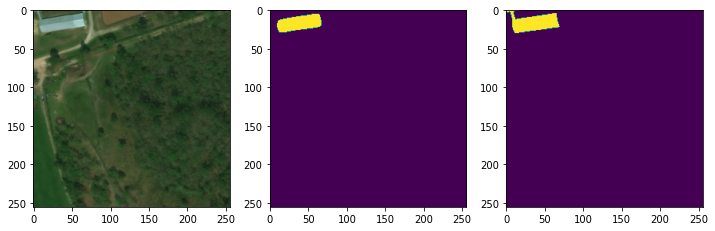

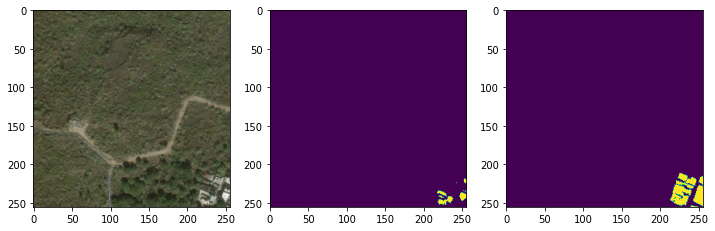

In [18]:
# ======================
# Visualize results for val set
# ======================

model.eval()

for n in range(len(val_dataset)):
    input, output, rgb_path = val_dataset[n]
    x_tensor = torch.from_numpy(input).to(device).unsqueeze(0)
    output = output.squeeze()

    prediction = model(x_tensor)
    prediction = (prediction > prediction_threshold).long().squeeze().cpu().numpy().round()

    rgb = input.transpose(1, 2, 0)

    plt.figure(figsize=(12,12))
    plt.subplot(1,3,1)
    plt.imshow(rgb[:,:,[2,1,0]]/255)
    plt.subplot(1,3,2)
    plt.imshow(prediction)
    plt.subplot(1,3,3)
    plt.imshow(output)
    plt.show()

    rgb_fname = pathlib.Path(rgb_path).stem
    prediction = (prediction*255).astype('uint8')
    prediction = cv2.resize(prediction, (512, 512), interpolation=cv2.INTER_CUBIC)
    # save prediction with the original image size
    # cv2.imwrite(pred_dir + rgb_fname + '.png', prediction)

# Visualize Predicted Label Images in Test Set

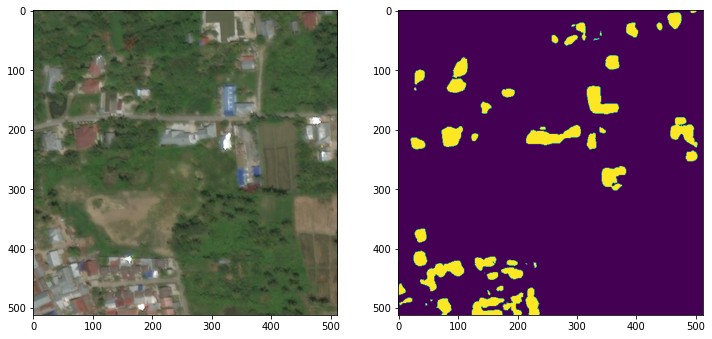

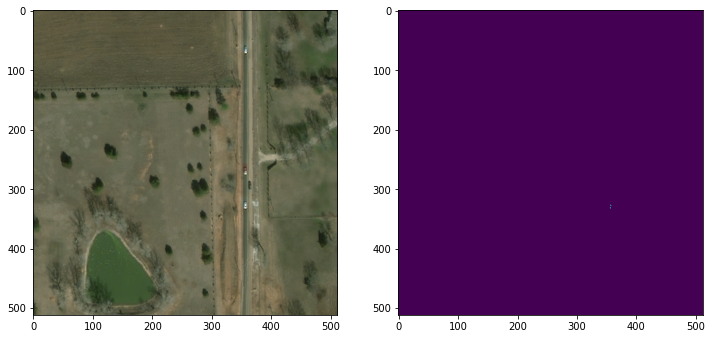

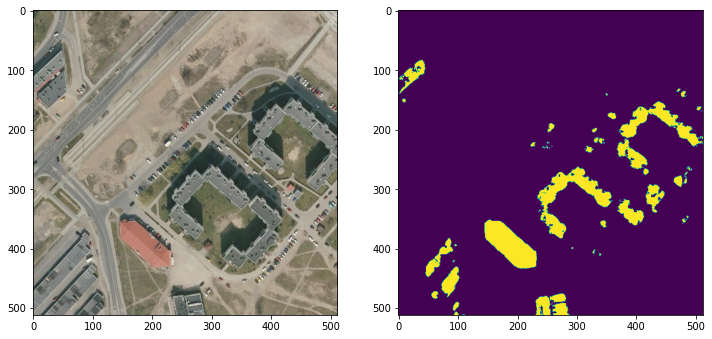

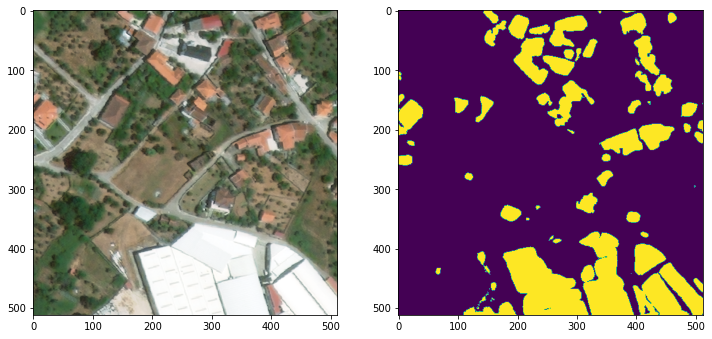

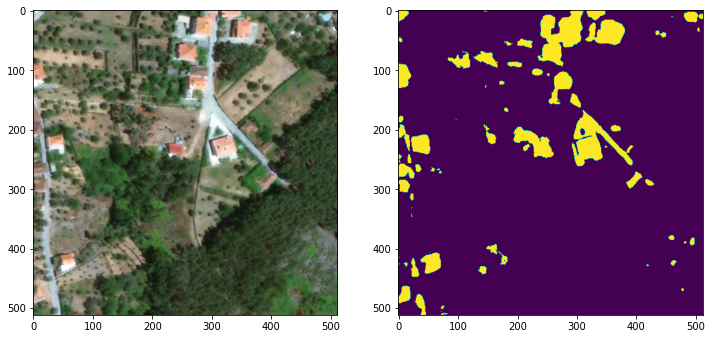

...

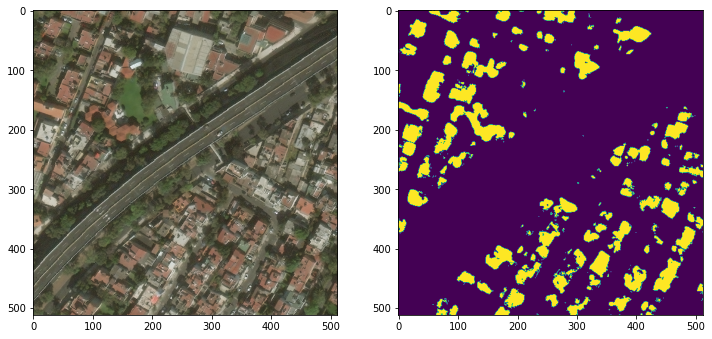

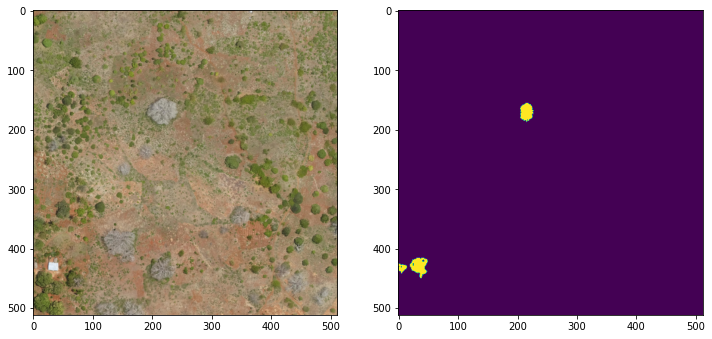

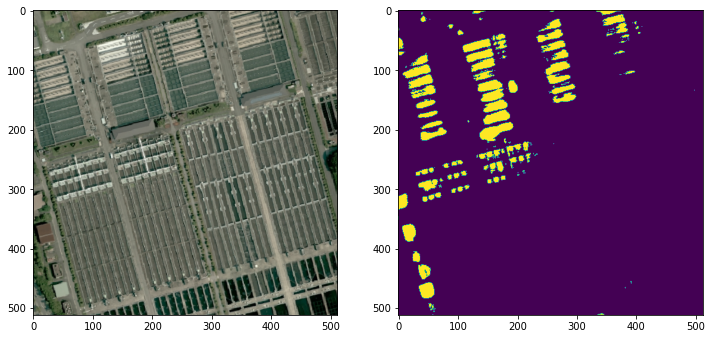

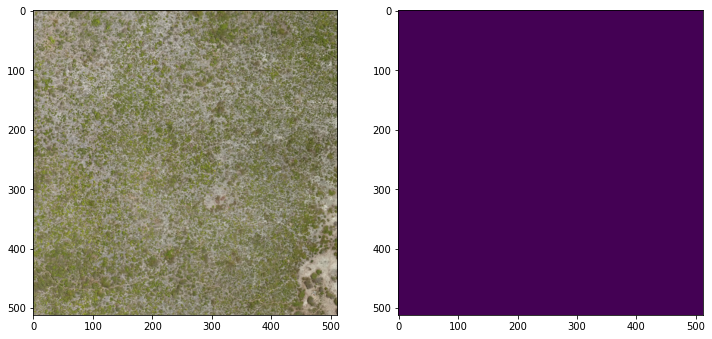

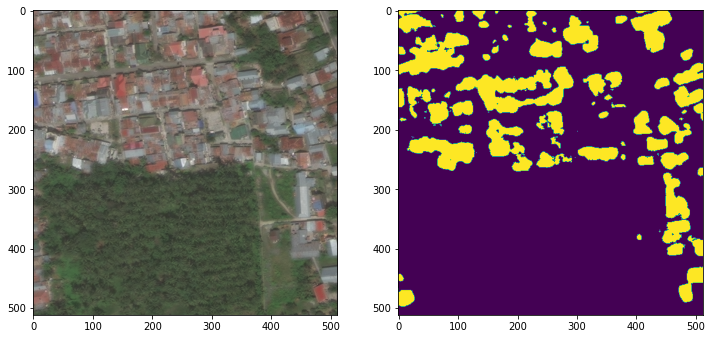

In [19]:
from glob import glob

x_test_dir = os.path.join(data_dir, 'test_img')
test_files = glob(x_test_dir + '/*.png')

model.eval()

for f in test_files:
    image = cv2.imread(f, cv2.IMREAD_COLOR)
    input = image.transpose(2, 0, 1).astype('float32')
    x_tensor = torch.from_numpy(input).to(device).unsqueeze(0)

    prediction = model(x_tensor)
    prediction = (prediction > prediction_threshold).long().squeeze().cpu().numpy().round()

    rgb = input.transpose(1, 2, 0)

    plt.figure(figsize=(12,12))
    plt.subplot(1,2,1)
    plt.imshow(rgb[:,:,[2,1,0]]/255)
    plt.subplot(1,2,2)
    plt.imshow(prediction)
    plt.show()

    rgb_fname = pathlib.Path(f).stem
    prediction = (prediction*255).astype('uint8')
    prediction = cv2.resize(prediction, (512, 512), interpolation=cv2.INTER_CUBIC)

    # save prediction with the original image size
    cv2.imwrite(pred_dir + rgb_fname + '.png', prediction)